<a href="https://colab.research.google.com/github/gyaneshhere/Gemini/blob/main/gemini_solution_challenge.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Best Practices for Multimodal Prompt Engineering
## A workshop by Rishiraj Acharya, GDE (AI & Cloud)

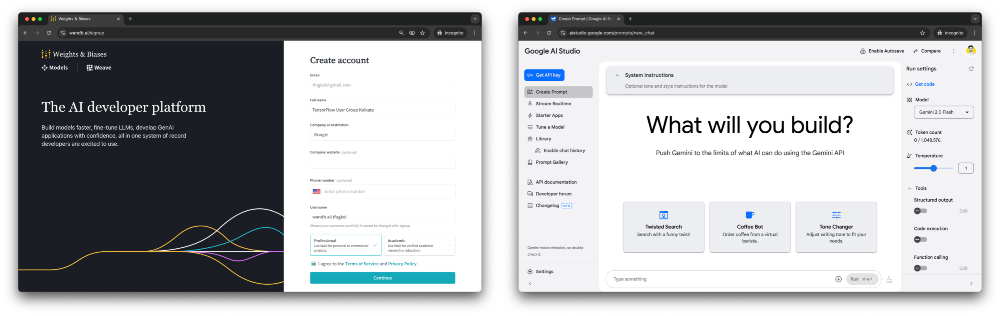

## Setup

In [1]:
!pip install -q weave
!wandb login

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 409.5/409.5 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.5/45.5 kB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 590.6/590.6 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 325.8/325.8 kB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 203.2/203.2 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.3/74.3 kB 2.7 MB/s eta 0:00:00
wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: gyaneshhere to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


In [2]:
!git clone https://github.com/rishiraj/gemini-workshop.git

Cloning into 'gemini-workshop'...
remote: Enumerating objects: 34, done.
remote: Counting objects: 100% (13/13), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 34 (delta 2), reused 7 (delta 0), pack-reused 21 (from 2)
Receiving objects: 100% (34/34), 54.78 MiB | 15.44 MiB/s, done.
Resolving deltas: 100% (2/2), done.


In [6]:
import weave
import json
import base64
import os
import time
from google import genai
from google.genai import types
from google.colab import userdata

client = genai.Client(api_key=userdata.get('GEMINI_API_KEY'))
model = "gemini-2.0-flash-lite"

@weave.op() # 🐝 Decorator to track requests
def generate(user_prompts, system_prompt="", tools=[], temperature=1, top_p=0.95, top_k=40, max_output_tokens=8192):
    """
    Generates content based on a system prompt and a list of user inputs.

    Parameters:
        user_prompts (list): A list of user inputs, which can include text or uploaded files.
        system_prompt (str, optional): The system instruction text.
        tools (list, optional): A list of tools to use for generating content.
        temperature (float, optional): Sampling temperature. Defaults to 1.
        top_p (float, optional): Nucleus sampling probability. Defaults to 0.95.
        top_k (int, optional): Number of top-ranked tokens to consider. Defaults to 40.
        max_output_tokens (int, optional): Maximum number of output tokens. Defaults to 8192.
    """
    contents = []

    for prompt in user_prompts:
        if isinstance(prompt, str):  # Handle text inputs
            contents.append(
                types.Content(
                    role="user",
                    parts=[types.Part.from_text(text=prompt)],
                )
            )
        elif hasattr(prompt, "uri") and hasattr(prompt, "mime_type"):  # Handle file inputs
            contents.append(
                types.Content(
                    role="user",
                    parts=[
                        types.Part.from_uri(
                            file_uri=prompt.uri,
                            mime_type=prompt.mime_type,
                        )
                    ],
                )
            )

    generate_content_config = types.GenerateContentConfig(
        temperature=temperature,
        top_p=top_p,
        top_k=top_k,
        max_output_tokens=max_output_tokens,
        response_mime_type="text/plain",
        system_instruction=[types.Part.from_text(text=system_prompt)],
        tools=tools
    )

    # for chunk in client.models.generate_content_stream(
    #     model=model,
    #     contents=contents,
    #     config=generate_content_config,
    # ):
    #     print(chunk.text, end="")

    response = client.models.generate_content(
        model=model,
        contents=contents,
        config=generate_content_config,
    )
    return response

weave.init('solutionchallenge-kolkata')

In [7]:
from IPython.display import Image, Video, display

def show_media(file_path):
    ext = file_path.split('.')[-1].lower()
    if ext in ['jpg', 'jpeg', 'png', 'gif']:
        display(Image(file_path, height=350))
    if ext in ['mp4', 'webm', 'ogg']:
        display(Video(file_path, width=450, embed=True))
        video = client.files.upload(file=file_path)
        time.sleep(10)
        return video
    return client.files.upload(file=file_path)

## Text Examples

In [8]:
generate(["Explain GDG on Campus Solution Challenge India in 2 lines."]).text

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8ea-2bf2-7d31-afb8-1278f42272dc


"GDG on Campus Solution Challenge India empowers student developers to solve local problems using Google technologies. It's a chance to build innovative solutions and gain valuable skills.\n"

## Multimodality: Image + Text

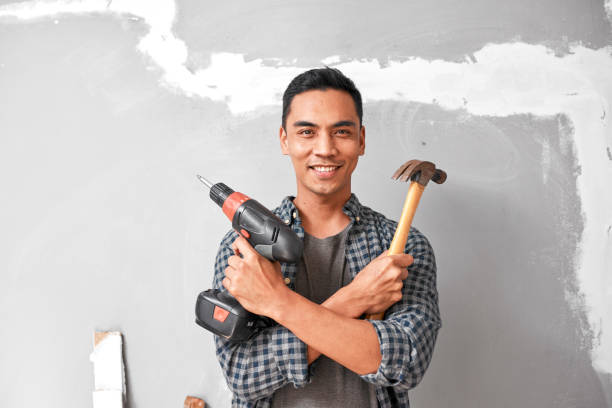

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8ea-50f4-7c43-9a3c-0a6232194b13


"The image features a young Asian man holding a hammer and a cordless drill, seemingly posing in front of a wall that appears to be under construction or renovation. He is smiling at the camera, suggesting a confident or possibly playful attitude. The man is wearing a plaid shirt over a gray t-shirt, making him look like he's in a relaxed and casual attire. The wall behind him is painted a gray color, with visible signs of previous work or damage. The presence of the tools and the wall suggest this is a renovation or handyman context.\n"

In [9]:
prompt = "Please describe what is in this image?"
image = show_media("/content/gemini-workshop/builder.jpg")

generate([prompt, image]).text

## Multimodality: Video + Text

In [10]:
prompt = """
Answer the following questions using the video only:
 - What is the main person's profession?
 - What are the main features of the phone highlighted?
 - Which city was this recorded in?
"""
video = show_media("/content/gemini-workshop/pixel8.mp4")

generate([prompt, video]).text

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8ea-8c86-7b90-bb2c-78c5d8c2dc8d


'Here are the answers to your questions:\n\n- The main person\'s profession is a photographer.\n- The main feature of the phone highlighted is "Video Boost".\n- This video was recorded in Tokyo.'

## Gemini Model Parameters

### Setting `temperature=0.0` and `top_k=1`

In [11]:
generate(["Explain GDG on Campus Solution Challenge India in 2 lines."], temperature=0, top_k=1).text

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8ea-9643-7b20-8058-a428754ad956


'The GDG on Campus Solution Challenge India is a Google-sponsored competition where student teams develop innovative solutions to real-world problems using Google technologies. It encourages students to build impactful projects and showcase their skills.\n'

In [12]:
generate(["Explain GDG on Campus Solution Challenge India in 2 lines."], temperature=0, top_k=1).text

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8ea-98e0-70a2-baaf-ebb935206552


'The GDG on Campus Solution Challenge India is a Google-sponsored competition where student teams develop innovative solutions using Google technologies. It encourages students to solve real-world problems and showcase their technical skills.\n'

### Setting `temperature=1` and `top_k=40`

In [13]:
generate(["Explain GDG on Campus Solution Challenge India in 2 lines."], temperature=1, top_k=40).text

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8ea-a08c-7f60-8c91-4c132abfee24


'The GDG on Campus Solution Challenge India is a nationwide competition where students develop innovative solutions to real-world problems using Google technologies. It empowers student developers to showcase their skills and make a positive impact.\n'

### Setting `top_p=0.01`, and maintaining `temperature=1`, `top_k=40`

In [14]:
generate(["Explain GDG on Campus Solution Challenge India in 2 lines."], temperature=1, top_p=0.01, top_k=40).text

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8ea-a9dc-74e0-a6ee-a5a19edcfe26


'The GDG on Campus Solution Challenge India is a Google-sponsored competition where student teams develop innovative solutions using Google technologies. It encourages students to solve real-world problems and showcase their technical skills.\n'

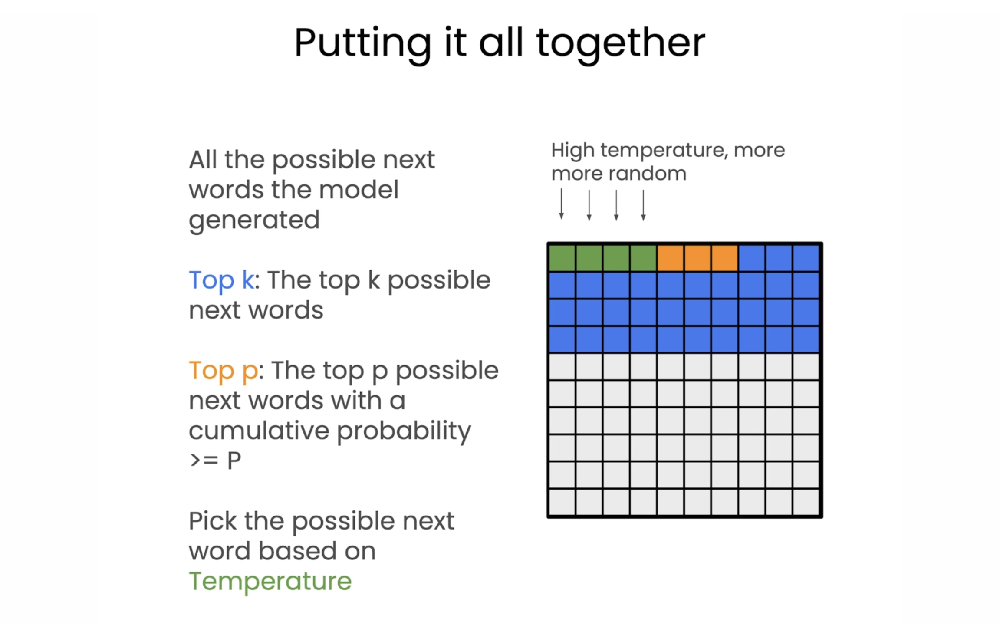

### Max Output Tokens

In [15]:
generate(["Explain GDG on Campus Solution Challenge India in 2 lines."], max_output_tokens=10).text

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8ea-b84f-7743-998b-a6c57253fb1f


'The GDG on Campus Solution Challenge India is a'

## Use Cases with Images

### Let's make a Fruit Salad!

In [16]:
instruction_1 = """
I want to make a fruit salad with three bananas, two apples, \
one kiwi, and one orange. This is an image of my bowl \
of fruits:
"""

In [17]:
instruction_2 = "This is the price list for fruits at \
my supermarket:"

In [18]:
question = """
Please answer these questions:
- Describe which fruits and how many I have in my fruit bowl on \
the image?
- Given the fruits in my bowl on the image and the fruit salad \
recipe, what am I missing?
- Given the fruits I still need to buy, what \
would be the prices and total cost for these fruits?
"""

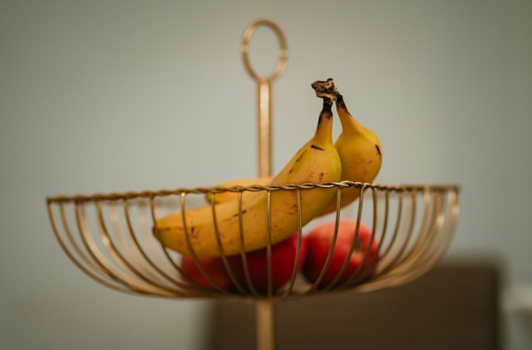

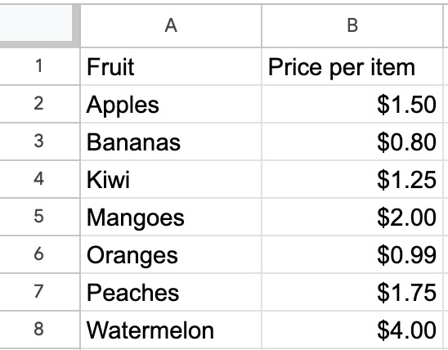

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8ea-e5ce-79f2-8d26-f42854334310


"Let's break this down:\n\n*   **Fruits in your bowl:** Based on the image, you have 3 bananas and 2 apples.\n\n*   **Fruits you need for the salad:**\n    *   3 Bananas (you have enough)\n    *   2 Apples (you have enough)\n    *   1 Kiwi (missing)\n    *   1 Orange (missing)\n\n*   **Cost of missing fruits:**\n    *   Kiwi: $1.25\n    *   Oranges: $0.99\n    *   **Total Cost:** $1.25 + $0.99 = $2.24"

In [19]:
fruit = show_media("/content/gemini-workshop/example1/fruits.png")
prices = show_media("/content/gemini-workshop/example1/prices.png")

generate([instruction_1, fruit, instruction_2, prices, question]).text

### Your very own Interior Designer!

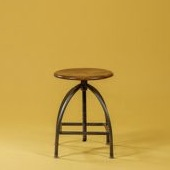

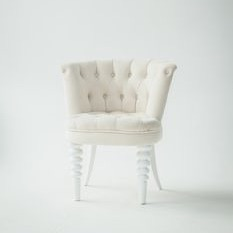

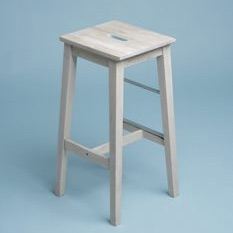

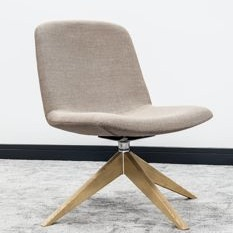

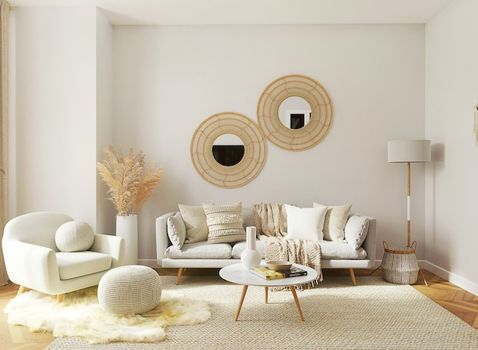

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8eb-02f8-73c3-9e37-db52efaff5fc


"Here's an assessment of each chair in relation to the room's style:\n\n*   **Chair 1:** This chair appears to be an adjustable stool. The industrial style of this chair would clash with the room's current aesthetic, which leans heavily towards a relaxed, bohemian or coastal-inspired style. It would not fit the style of the room.\n\n*   **Chair 2:** This chair has a traditional or even a slight French-inspired look. The tufting and the shapely legs offer a touch of elegance. However, the room is already leaning toward the bohemian/coastal style. It is unlikely to fit the style of the room.\n\n*   **Chair 3:** This is a simple, contemporary stool. The modern style would contrast with the existing aesthetic. It is unlikely to fit the style of the room.\n\n*   **Chair 4:** This is a modern chair with a clean design. The wooden base would pair well with the furniture already in the room. This chair could blend in well with the room's style, as the color is neutral and the design is streaml

In [20]:
chair1 = show_media("/content/gemini-workshop/example2/chair1.png")
chair2 = show_media("/content/gemini-workshop/example2/chair2.png")
chair3 = show_media("/content/gemini-workshop/example2/chair3.png")
chair4 = show_media("/content/gemini-workshop/example2/chair4.png")
room_image = show_media("/content/gemini-workshop/example2/room.png")

generate([
    "You are an interior designer. Consider the following chairs:",
    "chair 1:",
    chair1,
    "chair 2:",
    chair2,
    "chair 3:",
    chair3,
    "chair 4:",
    chair4,
    "room:",
    room_image,
    "For each chair, explain whether it would be appropriate for the style of the room."]).text

### Need to request Business Expense Reimbursement?

In [21]:
INSTRUCTION = "Never make up facts, and if you are not 100% sure, \
be transparent in stating when you are not sure, or do not \
have enough information to answer certain questions or \
fulfill certain requests."

In [22]:
ROLE = "You are an HR professional and an expert in travel expenses."

In [23]:
ASSIGNMENT = """
You are reviewing travel expenses for a business trip.
Please complete the following tasks:
1. Itemize everything on the receipts, including tax and \
total.  This means identifying the cost of individual \
items that add up to the total cost before tax, as well \
as the tax ,such as sales tax, as well as tip.
2. What is the total sales tax paid?  In some cases, \
the total sales tax may be a sum of more than one line \
item of the receipt.
3. For this particular receipt, the employee who is \
adding this business expense purchased the meal with \
a group. The employee only ordered the KFC Bowl. Please \
provide the cost of the employee's order only.  Include \
both the cost before tax, and also estimate the tax \
that is applied to this employee's order.  To do this,\
calculate the fraction of the employee's pre-tax order\
divided by the total pre-tax cost.  This fraction can be \
applied to the total sales tax that you calculated earlier.
4.  Please calculate the amount spent by others, which \
are all the other line items on the receipt.  Please \
provide this sum before tax, and if possible, apply the \
tax for the total cost.
5. Check the expenses against company policy and flag \
if there are issues.
"""

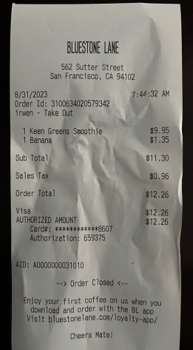

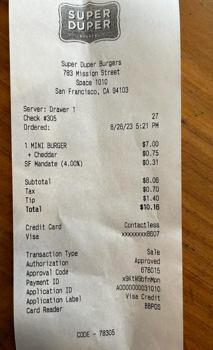

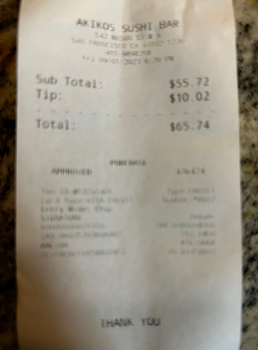

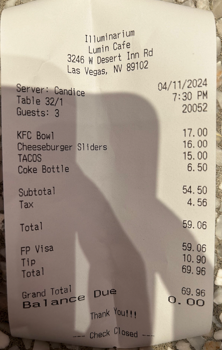

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8eb-41bc-7673-a675-2a0795ed60ef


"Okay, I will analyze each of the provided receipts and provide the information you requested.\n\n**Breakfast - Bluestone Lane**\n\n1.  **Itemization:**\n\n    *   1 Keen Greens Smoothie: $9.95\n    *   1 Banana: $1.35\n    *   Subtotal: $11.30\n    *   Sales Tax: $0.96\n    *   Order Total: $12.26\n    *   Tip: Not listed\n2.  **Total Sales Tax:** $0.96\n3.  **Employee Order Analysis:** This receipt only shows the employee's order. The employee ordered a Keen Greens Smoothie ($9.95) and a Banana ($1.35).\n    *   Total before tax: $11.30\n    *   Tax on Employee's Order: $0.96 (This is the total sales tax and applies to the employee's order)\n4.  **Expenses for Others:** There are no other line items on this receipt.\n5.  **Company Policy:** There is no clear violation of company policy on the receipt.\n\n**Lunch - Super Duper Burgers**\n\n1.  **Itemization:**\n\n    *   1 MINI BURGER + Cheddar: $7.00\n    *   SF Mandate (4.00%): $0.31\n    *   Subtotal: $8.06\n    *   Tax: $0.70\n   

In [24]:
bill1 = show_media("/content/gemini-workshop/example3/bill1.png")
bill2 = show_media("/content/gemini-workshop/example3/bill2.png")
bill3 = show_media("/content/gemini-workshop/example3/bill3.png")
bill4 = show_media("/content/gemini-workshop/example3/bill4.png")
policy = show_media("/content/gemini-workshop/example3/travel-policy.txt")

generate([
    "Answer the questions based on the following receipts:"
    "breakfast:",
    bill1,
    "lunch:",
    bill2,
    "diner",
    bill3,
    "meal-others",
    bill4], system_prompt=f"{INSTRUCTION}\n{ROLE}\n{ASSIGNMENT}\n{policy}").text

## Use Cases with Videos

### Digital Marketer

In [25]:
role = """
You are a great digital marketer working on a new video.
"""

In [26]:
tasks = """
You will add the video to your website and to do this you
need to complete some tasks. Please make sure your answer
is structured.

Tasks:
- What is the title of the video?
- Write a summary of what is in the video.
- Generate metadata for the video in JSON that includes:\
Title, short description, language, and company.
"""

In [27]:
video = show_media("/content/gemini-workshop/example4/vertex-ai-langchain.mp4")

generate([tasks, video], system_prompt=role).text

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8eb-939d-7982-aa30-538ad4f3f626


ClientError: 400 FAILED_PRECONDITION. {'error': {'code': 400, 'message': 'The File te57x3hcxuu3 is not in an ACTIVE state and usage is not allowed.', 'status': 'FAILED_PRECONDITION'}}

### Explaining the Educational Concepts

In [ ]:
prompt = """
Please have a look at the video and answer the following
questions.

Questions:
- Question 1: Which concept is explained in the video?
- Question 2: Based on your answer to Question 1,
can you explain the basic math of this concept?
- Question 3: Can you provide a simple scikit code example
explaining the concept?
"""

In [ ]:
video = show_media("/content/gemini-workshop/example5/descending-into-ml.mp4")

generate([video, prompt]).text

### Extracting Information

In [ ]:
questions = """
Answer the following questions using the video only.

Questions:
- What is the most searched sport?
- Who is the most searched scientist?
"""

In [ ]:
format_html = """
Format:
Present the results in a table with a row for each question
and its answer.
Make sure the table is in markdown format.
"""

In [ ]:
video = show_media("/content/gemini-workshop/example6/google-search.mp4")

generate([video, questions, format_html]).text

## Function Calling

### Asking for Real-Time Information from LLMs

In [28]:
generate(["What's the exchange rate for euros to dollars today?"]).text

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8eb-9a75-7f62-836e-dd66f2621de2


'I am unable to provide live, real-time exchange rates. These rates fluctuate constantly.\n\nHowever, here\'s how you can find the most up-to-date information:\n\n*   **Use a reliable financial website:**\n    *   Google Finance: Just search "EUR to USD" on Google.\n    *   Yahoo Finance: finance.yahoo.com\n    *   Bloomberg: bloomberg.com\n    *   Reuters: reuters.com/markets/currencies\n    *   Other reputable financial news sources.\n*   **Use a currency converter app:** There are many free currency converter apps for your phone.\n\nWhen you check, you\'ll see the most current exchange rate. Remember that the rate you see is usually the "mid-market rate," and the actual rate you get when exchanging money might be slightly different due to bank fees and other factors.\n'

In [29]:
url = "https://api.frankfurter.app/latest"

import requests
response = requests.get(url)
response.text

'{"amount":1.0,"base":"EUR","date":"2025-03-24","rates":{"AUD":1.7223,"BGN":1.9558,"BRL":6.2314,"CAD":1.552,"CHF":0.9544,"CNY":7.8513,"CZK":24.97,"DKK":7.4591,"GBP":0.83663,"HKD":8.4141,"HUF":398.08,"IDR":17924,"ILS":4.0041,"INR":92.62,"ISK":144.7,"JPY":162.15,"KRW":1588.2,"MXN":21.832,"MYR":4.7994,"NOK":11.3795,"NZD":1.8908,"PHP":62.067,"PLN":4.176,"RON":4.9756,"SEK":10.957,"SGD":1.448,"THB":36.666,"TRY":41.131,"USD":1.0824,"ZAR":19.6168}}'

In [30]:
from google.genai.types import (
    FunctionDeclaration,
    Tool,
)

### Declaring Functions

In [31]:
get_exchange_rate_func = FunctionDeclaration(
    name="get_exchange_rate",
    description="Get the exchange rate for currencies "
                "between countries",
    parameters={
        "type": "object",
        "properties": {
            "currency_date": {
                "type": "string",
                "description": "'latest' if a time period is not "
                               "specified"
            },
            "currency_from": {
                "type": "string",
                "description": "The currency to convert from "
                               "in ISO 4217 format"
            },
            "currency_to": {
                "type": "string",
                "description": "The currency to convert to "
                               "in ISO 4217 format"
            }
        },
        "required": [
            "currency_from",
            "currency_date",
        ]
    },
)

### Define a Tool

In [32]:
exchange_rate_tool = Tool(
    function_declarations=[get_exchange_rate_func],
)

In [33]:
prompt = """What is the exchange rate from Australian dollars to
Swedish krona? How much is 500 Australian dollars worth in
Swedish krona?"""

In [34]:
response = generate([prompt], tools=[exchange_rate_tool])
response.candidates[0].content

🍩 https://wandb.ai/gyaneshhere/solutionchallenge-kolkata/r/call/0195c8eb-d618-74f2-8718-1bb7647e73d0


Content(parts=[Part(video_metadata=None, thought=None, code_execution_result=None, executable_code=None, file_data=None, function_call=None, function_response=None, inline_data=None, text='What is the exact date you would like to use to determine the exchange rate?')], role='model')

### External API Call

In [35]:
params = {}
for key, value in response.candidates[0].content.parts[0]\
                          .function_call.args.items():
    params[key[9:]] = value
params

AttributeError: 'NoneType' object has no attribute 'args'

In [36]:
url = f"https://api.frankfurter.app/{params['date']}"
api_response = requests.get(url, params=params)
api_response.text

KeyError: 'date'

### Passing the Information Back to the LLM

In [37]:
generate([prompt, api_response.text]).text

NameError: name 'api_response' is not defined